<a href="https://colab.research.google.com/github/fcastellanosp/MINE-4210_202420_ADL/blob/main/Laboratorios/Laboratorio%202/MINE4210_ADL2024_Lab2_S2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![Logo ADL](https://github.com/fcastellanosp/MINE-4210_202420_ADL/blob/main/Laboratorios/logo_adl.png?raw=true)

**Tutores**.
* Nicolás Tibatá Casteñeda.
* Fabián Camilo Castellanos P.

#Tabla de contenido

[Contexto y objetivos.](#scrollTo=2WxzklpGkNqh)<br>
[Entendimiento del negocio.](#scrollTo=sWukAen75VQp)<br>
[0. Instalación de librerías.](#scrollTo=f8VSLdvq5jl3)<br>
[1. Importar librerías](#scrollTo=h1qls6_Z5nY2)<br>
[2. Introducción a los datos.](#scrollTo=5djzJp_u5u3n)<br>
[3. Modelamiento.](#scrollTo=TqkCZypY66gu)<br>
&emsp;[3.1. Inception.](#scrollTo=TqkCZypY66gu)<br>
&emsp;[3.2. VGG16.](#scrollTo=Ot8XPnTF73c2)<br>
[4. Preguntas.](#scrollTo=i2AP73Nt8SUF)<br>

# **Laboratorio 2 - Sesión 2**
## **Redes Convolucionales**

## **Objetivos**
*   Realizar la carga y procesamiento de imágenes.
*   Analizar la estructura de una Red Neuronal Convolucional Pre-entrenada.
*   Realizar la transferencia de conocimiento de las Redes Preentrenadas.


## **Problema**
- Uno de los grandes avances que se han propuesto a través de la Visión por Computador es la clasificación de imágenes. Donde a través de ellas se puede establecer directamente a que clase o etiqueta pertenece una imágen sin necesidad de intervención humana. Así que para ello, hemos recuperado un conjunto de imágenes que nos ayudará a entender los conceptos básicos de las Redes Convolucionales a través de la [clasificación de imágenes de animales](https://www.kaggle.com/datasets/borhanitrash/animal-image-classification-dataset).

# Entendimiento del negocio.

Para tener un mejor detalle sobre el comportamiento de la información, la organización organizó la información de la siguiente forma:

```python
datasets/
  cats/
    a_image_1.jpg
    a_image_2.jpg
    .......
  dogs/
    a_image_1.jpg
    a_image_2.jpg
    .......
  snakes/
    a_image_1.jpg
    a_image_2.jpg
    .......
```

# 0. Instalación de librerías
Para la transformación de los datos, así como para el entrenamiento de los modelos y la visualización de los resultados, se importan las siguientes librerías:

In [1]:
!pip install kaggle

In [2]:
!pip install keras-applications

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 3.4 MB/s eta 0:00:00


In [3]:
!pip install keras-tuner

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 5.8 MB/s eta 0:00:00


---
# 1. Importar librerías

In [4]:
#Numpy y Pandas
import pandas as pd
import numpy as np
from numpy import asarray

#Librerías de Scikit Learn
import sklearn
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split

#Librerías de Keras y Tensor Flow
import tensorflow as tf
import keras_tuner as kt

from keras.models import Model, Sequential
from keras.layers import Dropout, Flatten, Dense, Input, Rescaling, Lambda, MaxPooling2D, Conv2D, AveragePooling2D, Activation, Reshape, GlobalAveragePooling2D
from keras import backend as K
from keras.utils import plot_model
from tensorflow.keras.applications import InceptionV3, VGG16
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam

#Gráficos
import matplotlib.pyplot as plt
%matplotlib inline

#Otras Librerías
import datetime
import os
import os.path as osp
from collections import defaultdict
from PIL import Image

#Verificamos las versiones de las librerías
print(f"La versión de sklearn es: {sklearn.__version__}")
print('Tensorflow version:', tf.__version__)

La versión de sklearn es: 1.3.2
Tensorflow version: 2.17.0


Este fragmento de código, nos permite evaluar si tenemos disponible una GPU dentro del ambiente de Google Colab:

In [5]:
device_name = tf.test.gpu_device_name()
gpu_name = '/device:GPU:0'
if device_name != gpu_name:
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


---
# 2. Introducción a los datos.

##2.1. Parámetros generales y carga de la información.

Los parámetros de porcentaje de datos de prueba y la reproducibilidad:

In [6]:
#Porcentaje para validación y test
test_alpha = 0.2
#random_state o semilla para la reproducibilidad
my_seed = 19

Definimos algunos parámetros, como el tamaño del batch y el tamaño de las imágenes a cargar.

In [7]:
batch_size = 32
img_height = 224
img_width = 224
band_count = 3 #Número de bandas en las imágenes

## 2.2. Configuración del entorno de kaggle.

Preparar el archivo de kaggle para la descarga

In [8]:
!ls -lha kaggle.json
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

-rw-r--r-- 1 root root 69 Sep  4 14:07 kaggle.json


Verificamos la conectividad con kaggle, usando un comando para ver una previsualización de datasets:

In [9]:
!kaggle datasets list

ref                                                                  title                                           size  lastUpdated          downloadCount  voteCount  usabilityRating  
-------------------------------------------------------------------  ---------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
stefanydeoliveira/summer-olympics-medals-1896-2024                   Summer Olympics Medals (1896-2024)               4MB  2024-08-29 23:52:10           1115         25  1.0              
haseebindata/student-performance-predictions                         Student Performance Predictions                  9KB  2024-08-17 06:57:57           6718        143  0.9411765        
berkayalan/paris-2024-olympics-medals                                Paris 2024 Olympics Medals                       1KB  2024-08-14 11:02:45           5686        102  1.0              
uom190346a/ai-powered-job-market-insights                   

Una vez hemos asegurado la conectividad, procedemos a realizar el proceso de descarga de la información del negocio.

In [10]:
!kaggle datasets download borhanitrash/animal-image-classification-dataset

Dataset URL: https://www.kaggle.com/datasets/borhanitrash/animal-image-classification-dataset
License(s): MIT
 91% 35.0M/38.4M [00:01<00:00, 27.5MB/s]
100% 38.4M/38.4M [00:01<00:00, 20.5MB/s]


La información descargada en formato zip, cuenta con un archivo csv en su interior, si vieramos de forma gráfica su estructura, sería la siguiente:

```python
animal-image-classification-dataset.zip/
  Animals/
    cats/
      a_image_1.jpg
      a_image_2.jpg
      .......
    dogs/
      a_image_1.jpg
      a_image_2.jpg
      .......
    snakes/
      a_image_1.jpg
      a_image_2.jpg
      .......
```

Teniendo en cuenta lo anterior, vamos a descomprimir la información, es necesario crear un un directorio para que el contenido del archivo zip, se encuentre allí. Para este propósito, vamos a crear unas variables de manejo de archivos:

In [11]:
ROOT_DIR = '/content'
DATASET_NAME = 'animal-image-classification-dataset'

Vamos ahora a generar una previsualización del comando de descompresión del archivo zip:

In [12]:
print(f"!unzip {DATASET_NAME}.zip -d {ROOT_DIR}/{DATASET_NAME}")

!unzip animal-image-classification-dataset.zip -d /content/animal-image-classification-dataset


Ahora si vamos a consolidar el bloque de comandos con todos los pasos para la descompresión del archivo zip:

In [13]:
%cd {ROOT_DIR}
!mkdir /{DATASET_NAME}
!unzip {DATASET_NAME}.zip -d {ROOT_DIR}/{DATASET_NAME}

/content
Archive:  animal-image-classification-dataset.zip
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0001.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0002.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0003.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0004.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0005.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0006.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0007.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0008.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0009.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0010.jpg  
  inflating: /content/animal-image-classification-dataset/Animals/cats/0_0011.jpg  
  inflating: /con

Generamos la ruta del directorio para cargar la información:

In [14]:
DATA_DIR = f"{ROOT_DIR}/{DATASET_NAME}/Animals"
print(DATA_DIR)

/content/animal-image-classification-dataset/Animals


Generamos las particiones de los datos (80% train, 10% validación, 10% test):

In [15]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  DATA_DIR,
  label_mode='categorical',
  validation_split=test_alpha,
  subset="training",
  seed=my_seed,
  image_size=(img_height, img_width),
  batch_size=batch_size
)

Found 3000 files belonging to 3 classes.
Using 2400 files for training.


In [16]:
val_ds = tf.keras.utils.image_dataset_from_directory(
    DATA_DIR,
    label_mode='categorical',
    validation_split=test_alpha / 2,
    subset="validation",
    seed=my_seed,
    image_size=(img_height, img_width),
    batch_size=batch_size
)

Found 3000 files belonging to 3 classes.
Using 300 files for validation.


In [17]:
test_ds = tf.keras.utils.image_dataset_from_directory(
    DATA_DIR,
    label_mode='categorical',
    validation_split=test_alpha / 2,
    subset="validation",
    seed=my_seed,
    image_size=(img_height, img_width),
    batch_size=batch_size
)

Found 3000 files belonging to 3 classes.
Using 300 files for validation.


In [18]:
def load_and_resize_image(image_path, label):
  img_height_ = 224
  img_width_ = 224
  image = tf.io.read_file(image_path)
  image = tf.image.decode_jpeg(image, channels=3)  # Asumiendo que las imágenes son JPEG
  image = tf.image.resize(image, [img_height_, img_width_])  # Redimensionar a 224x224
  #image = image / 255.0  # Normalización si es necesario
  return image, label

Verificamos los nombres de las clases en los datos:

In [19]:
class_names = train_ds.class_names
print(class_names)

['cats', 'dogs', 'snakes']


Ahora vamos a verificar los tamaños de las imágenes:

In [20]:
print("----------ENTRENAMIENTO----------")
for images, labels in train_ds.take(1):
  print("Núm. Imágenes:", images.shape)
  print("Clases:", labels.shape)
  #print("Muestra de clases:", labels.numpy())

print("----------VALIDACIÓN----------")
for images, labels in val_ds.take(1):
  print("Núm. Imágenes:", images.shape)
  print("Clases:", labels.shape)
  #print("Muestra de clases:", labels.numpy())

----------ENTRENAMIENTO----------
Núm. Imágenes: (32, 224, 224, 3)
Clases: (32, 3)
----------VALIDACIÓN----------
Núm. Imágenes: (32, 224, 224, 3)
Clases: (32, 3)


Vamos a conocer cómo están distribuidos los datos de entrenamiento y validación:

In [21]:
def compute_class_dist(dataset):
  class_counts = defaultdict(int)
  num_classes = len(dataset.class_names)

  for images, labels in dataset:
    label_indices = tf.argmax(labels, axis=-1).numpy()
    for index in label_indices:
      class_counts[index] += 1

    distribution = [class_counts[i] for i in range(num_classes)]
    return distribution

In [22]:
train_distribution = compute_class_dist(train_ds)
val_distribution = compute_class_dist(val_ds)

In [23]:
def plot_class_dist(distribution, class_names, title):
  plt.bar(class_names, distribution)
  plt.xlabel('Class')
  plt.ylabel('Count')
  plt.title(title)
  plt.xticks(rotation=45)
  plt.show()

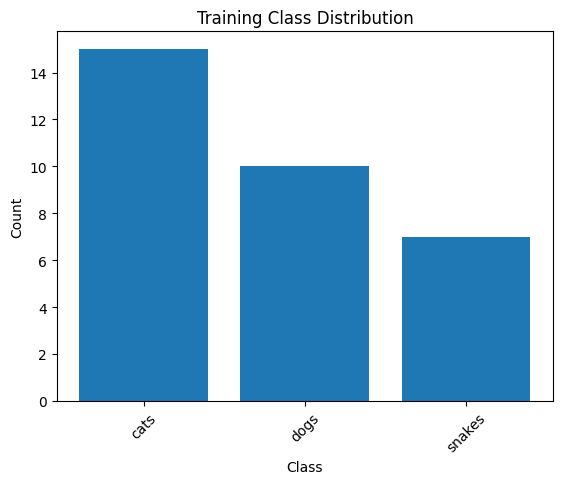

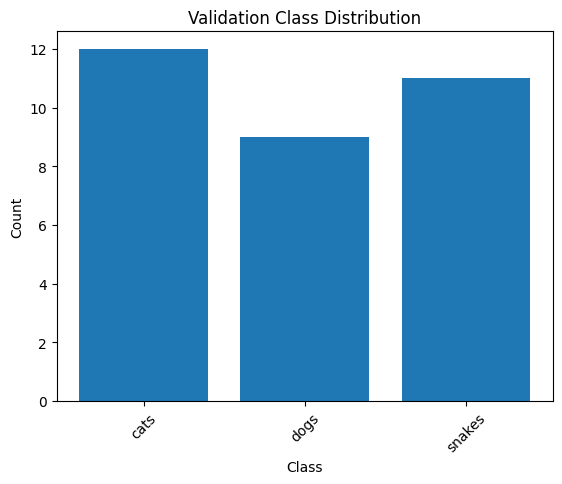

In [24]:
plot_class_dist(train_distribution, train_ds.class_names, 'Training Class Distribution')
plot_class_dist(val_distribution, val_ds.class_names, 'Validation Class Distribution')

## 2.3. Exploración de los datos.

Teniendo en cuenta que el proceso de exploración de la información fue desarrollado en el anterior laboratorio, continuaremos con el paso siguiente.

---
# 3. Modelamiento.

## 3.1. Entrenamiento con Inception.

¿De dónde toma el nombre la red pre-entrenada?

![Arquitectura Inception](https://github.com/fcastellanosp/MINE-4210_202420_ADL/blob/main/Laboratorios/Laboratorio%202/images/inception_movie.png?raw=true)

Sí!, de la película. Puedes dar un vistazo al paper "*Going Deeper with Convolutions*". Tomó forma buscando ir de una red, dentro de una red.

> Proponemos una arquitectura de red neuronal convolucional profunda con el nombre en clave de 'Inception', que fue responsable de establecer el nuevo estado del arte para la clasificación y detección en el Desafío de Reconocimiento Visual a Gran Escala de ImageNet 2014 (ILSVRC 2014). La principal característica de esta arquitectura es la mejora en la utilización de los recursos computacionales dentro de la red. Esto se logró mediante un diseño cuidadosamente elaborado que permite aumentar la profundidad y el ancho de la red mientras se mantiene constante el presupuesto computacional.

Szegedy, Liu, Jia, Sermanet, Reed, Anguelov, Erhan, Vanhoucke, Rabinovich, "*Going Deeper with Convolutions*", 2014.

### 3.1.1. Arquitectura de la red.

El diagrama general de funcionamiento de inceptión, es el siguiente:

![Arquitectura Inception](https://github.com/fcastellanosp/MINE-4210_202420_ADL/blob/main/Laboratorios/Laboratorio%202/images/inception.jpg?raw=true)

Si hacemos zoom a la red:

![Arquitectura Inception Detallada](https://github.com/fcastellanosp/MINE-4210_202420_ADL/blob/main/Laboratorios/Laboratorio%202/images/inception2.png?raw=true)

> Referencia:
Aurélien Géron, "*Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow*", 2a Edición, O'Reilly Media, 2019, Chapter 14, Figure 14-14.

El funcionamiento de la red podría resumirse de la siguiente forma:

*   Las primeras 2 capas dividen la imagen en 4 partes. El kernel es grande buscando preservar bastante información.
*   La tercera capa (*Locale response normalization*) asegura aprender muchas características.
*   Le siguen 2 capas convolucionales, dónde la primera actúa como "cuello de botella" para reducir la dimensionalidad.
*   El segundo local response busca aprender características.
*   Le siguen los 9 módulos de inception, con algunos MaPooling que buscan reducir la dimensionalidad y acelerar la red.
*   Global Average Pooling asegura la media de capa feature map. Borra la información espacial restante, esto está bien porque no es mucha información.
*   *Normalmente esta red espera imágenes de tamaño 224x224*, por lo tanto después de 5 Max Pooling Later va reduciendo a la mitad, de esta forma se reducen a 7x7.
*   La última capa es un DropOut para regularización y un fully connected de 1000 neuronas (ya que el número de clases es 1000) con una función de activación SoftMax para estimar las probabilidades.



### 3.1.2. Implementación.

Definimos el objeto pre-entrenado (modelo base):

In [25]:
inc_base_model_obj = InceptionV3(
    input_shape=(img_height, img_width, band_count),
    include_top=False,
    weights="imagenet",
)

inc_base_model_obj.summary()

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


Model: "inception_v3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 111, 111, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 111, 111, 32)   │             96 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, 111, 111, 32)   │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 109, 109, 32)   │          9,216 │ activation[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 109, 109, 32)   │             96 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, 109, 109, 32)   │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 109, 109, 64)   │         18,432 │ activation_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 109, 109, 64)   │            192 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_2 (Activation) │ (None, 109, 109, 64)   │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 54, 54, 64)     │              0 │ activation_2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 54, 54, 80)     │          5,120 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 54, 54, 80)     │            240 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_3 (Activation) │ (None, 54, 54, 80)     │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 52, 52, 192)    │        138,240 │ activation_3[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 52, 52, 192)    │            576 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_4 (Activat

 Total params: 21,802,784 (83.17 MB)

 Trainable params: 21,768,352 (83.04 MB)

 Non-trainable params: 34,432 (134.50 KB)

Congelamos los pesos de las capas pre-entrenadas

In [26]:
for layer in inc_base_model_obj.layers:
  layer.trainable = False

Manejamos la salida del modelo en una variable

In [27]:
x = inc_base_model_obj.output

 Es recomendable usar la capa ***GlobalAveragePooling2D*** en una red neuronal convolucional (CNN) como InceptionV3. Esta capa es una parte esencial para reducir la dimensionalidad de las características extraídas y prepararlas para la tarea final de clasificación. Luego de esta capa, puedes agregar tus propias capas densas (fully connected) para realizar la clasificación o cualquier tarea específica que necesites. Esto permite una mayor flexibilidad en la adaptación del modelo a tu tarea particular.

**Fully Connected**

In [28]:
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu', name='Capa_Densa_1')(x)

Capa de **Salida**

In [29]:
predictions = Dense(len(class_names), activation="softmax", name='Capa_Respuesta')(x)

Instanciamos el modelo con los parámetros anteriores:

In [30]:
inc_model = Model(inputs=inc_base_model_obj.input, outputs=predictions, name='RCN_Con_Conocimiento_1')

Verificamos cuáles de nuestras capas son entrenables:

In [31]:
for layer in inc_model.layers:
  if layer.trainable == True:
    print(f"{layer.name}: {layer.trainable}")

global_average_pooling2d: True
Capa_Densa_1: True
Capa_Respuesta: True


Observamos que corresponden a aquellas que especificamos en el Fully Connected.

Ya con nuestra arquitectura construida, compilamos nuestro modelo definiendo que función de pérdida, optimizador y métrica vamos a utilizar para construir nuestro modelo.

In [32]:
inc_model.compile(optimizer='adam', loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=["accuracy"])

Verificamos cómo está construido el modelo hasta este momento:

In [33]:
inc_model.summary()

Model: "RCN_Con_Conocimiento_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 111, 111, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 111, 111, 32)   │             96 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, 111, 111, 32)   │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 109, 109, 32)   │          9,216 │ activation[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 109, 109, 32)   │             96 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, 109, 109, 32)   │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 109, 109, 64)   │         18,432 │ activation_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 109, 109, 64)   │            192 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_2 (Activation) │ (None, 109, 109, 64)   │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 54, 54, 64)     │              0 │ activation_2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 54, 54, 80)     │          5,120 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 54, 54, 80)     │            240 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_3 (Activation) │ (None, 54, 54, 80)     │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 52, 52, 192)    │        138,240 │ activation_3[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 52, 52, 192)    │            576 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_4 (Activat

 Total params: 22,065,443 (84.17 MB)

 Trainable params: 262,659 (1.00 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

Vamos a preparar un TensorBoard:

In [34]:
log_dir = os.path.join("logs", "fit", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

En el caso que el entrenamiento no mejore, podemos definir una función de parada temprada mediante un EarlyStopping, allí definimos el parámetro de la paciencia y podemos especificar el número de épocas que esperaremos. La parada temprana irá en el callback de la siguiente forma:

In [35]:
my_callbacks = [
    tf.keras.callbacks.EarlyStopping(patience=5), tensorboard_callback
]

Ya con nuestro modelo construido y compilado. Ahora sí podemos pasar a entrenarlo.

In [36]:
with tf.device('/device:GPU:0'):
  history = inc_model.fit(train_ds, validation_data=val_ds, epochs=50, callbacks=my_callbacks)

Epoch 1/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 42s 318ms/step - accuracy: 0.5108 - loss: 13.7567 - val_accuracy: 0.6267 - val_loss: 1.8500
Epoch 2/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 12s 166ms/step - accuracy: 0.6048 - loss: 1.9464 - val_accuracy: 0.6333 - val_loss: 1.1326
Epoch 3/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 170ms/step - accuracy: 0.6491 - loss: 1.0556 - val_accuracy: 0.6000 - val_loss: 1.2123
Epoch 4/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 171ms/step - accuracy: 0.6624 - loss: 0.9211 - val_accuracy: 0.5867 - val_loss: 1.1335
Epoch 5/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 20s 161ms/step - accuracy: 0.6673 - loss: 0.9177 - val_accuracy: 0.6500 - val_loss: 1.0146
Epoch 6/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 165ms/step - accuracy: 0.6966 - loss: 0.7910 - val_accuracy: 0.6233 - val_loss: 1.0612
Epoch 7/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 179ms/step - accuracy: 0.6905 - loss: 0.8952 - val_accuracy: 0.5467 - val_loss: 1.7422
Epoch 8/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 19s 165ms/step - accuracy: 0.6822 - loss: 0.9028 - val_acc

Como verificamos en el laboratorio anterior, podemos ver como fue el comportamiento de la pérdida y la exactitud a medida que nuestro modelo fue aprendiendo durante las épocas.

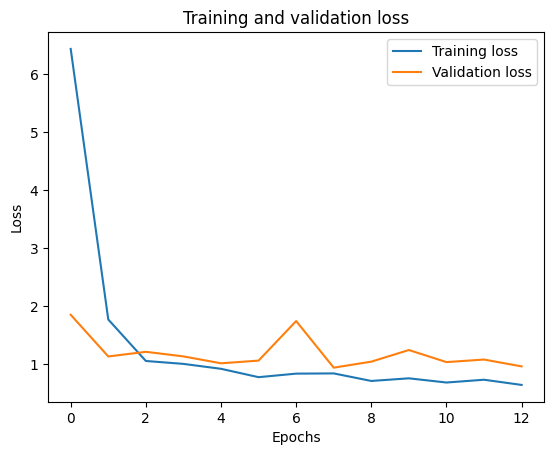

In [37]:
plt.plot(history.history['loss'], label='Training loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

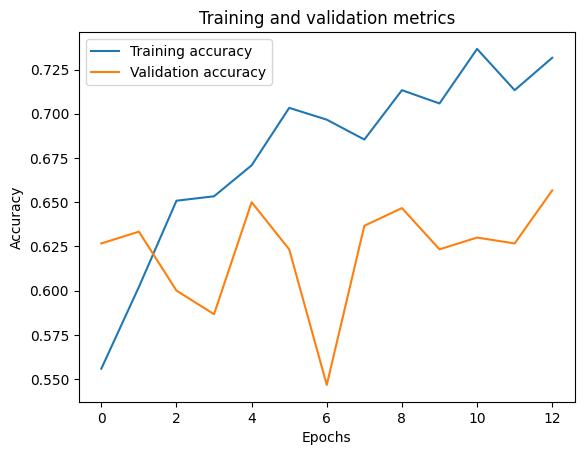

In [38]:
plt.plot(history.history['accuracy'], label='Training accuracy')
plt.plot(history.history['val_accuracy'], label='Validation accuracy')
plt.title('Training and validation metrics')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

Iniciamos el TensorBoard:

In [39]:
%load_ext tensorboard
%tensorboard --logdir logs/fit

Output hidden; open in https://colab.research.google.com to view.

¿Consideras que se presenta *overfitting*?

### 3.1.3. Predicción.

Al igual que con nuestros modelos anteriores, podemos realizar predicciones en nuestro conjunto de datos. Sin embargo, en este caso, debemos realizar una pequeña corrección en el proceso. Para obtener las etiquetas verdaderas y las etiquetas predichas, hemos recorrido el conjunto de datos de entrenamiento. En cada iteración, hemos utilizado el modelo para predecir las clases y luego hemos aplicado un umbral de 0.5 para asignar etiquetas binarias (1 si la probabilidad es mayor a 0.5 y 0 en caso contrario). Posteriormente, hemos convertido las listas resultantes en arreglos numpy para su posterior análisis y evaluación.

In [40]:
y_true = list()
y_pred = list()

for images, labels in train_ds:
  pred = inc_model.predict(images)
  for i in range(len(pred)):
    y_true.append(labels[i].numpy())
    y_pred.append((pred[i] == pred[i].max()).astype(int))

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_true, y_pred

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━

(array([[1., 0., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        ...,
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 0., 1.]], dtype=float32),
 array([[1, 0, 0],
        [1, 0, 0],
        [1, 0, 0],
        ...,
        [1, 0, 0],
        [0, 1, 0],
        [0, 0, 1]]))

Utilizaremos nuestro Reporte de Clasificación para poder interpretar los resultados del modelo.

In [41]:
print(classification_report(y_true, y_pred, target_names=list(class_names)))

              precision    recall  f1-score   support

        cats       0.60      0.90      0.72       790
        dogs       0.88      0.39      0.54       809
      snakes       0.86      0.92      0.89       801

   micro avg       0.74      0.74      0.74      2400
   macro avg       0.78      0.74      0.72      2400
weighted avg       0.78      0.74      0.72      2400
 samples avg       0.74      0.74      0.74      2400



1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


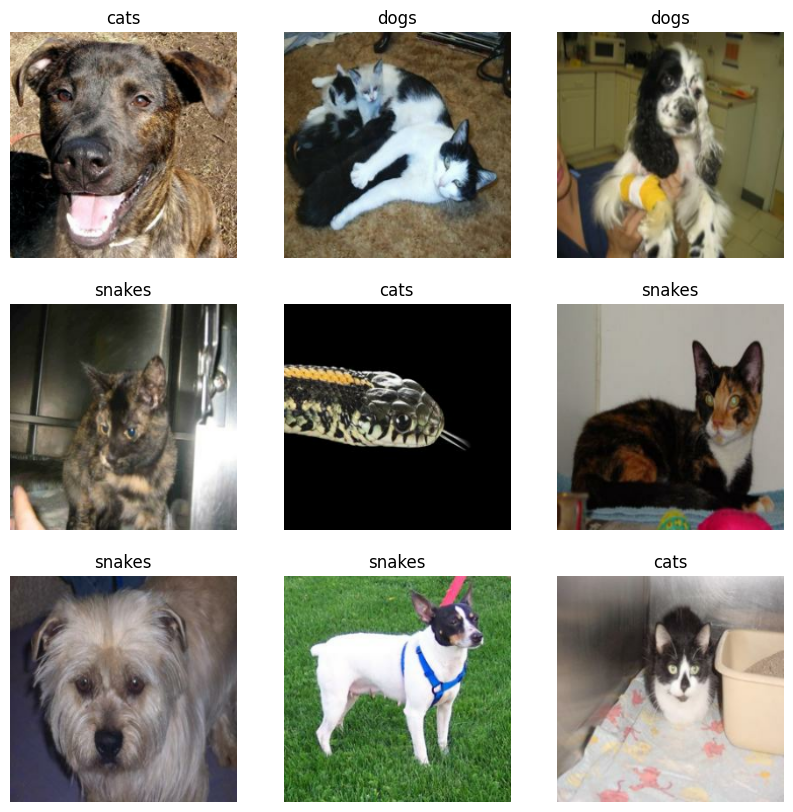

In [42]:
plt.figure(figsize=(10, 10))

df = train_ds.take(1)
pred = inc_model.predict(df)
for images, labels in df:
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[pred[i].argmax()])
    plt.axis("off")

### 3.1.4. Validación.

In [43]:
y_true = list()
y_pred = list()

for images, labels in val_ds:
  pred = inc_model.predict(images)
  for i in range(len(pred)):
    y_true.append(labels[i].numpy())
    y_pred.append((pred[i] == pred[i].max()).astype(int))

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_true, y_pred

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


(array([[1., 0., 0.],
        [0., 0., 1.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 1., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 1., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [0

Veamos la predicción aplicada en las imágenes:

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


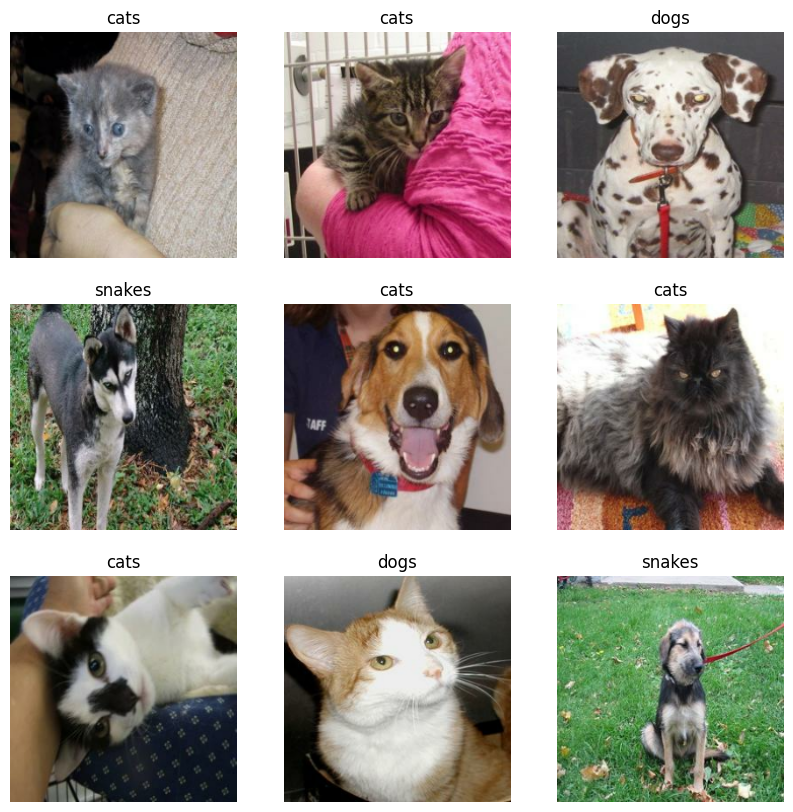

In [44]:
plt.figure(figsize=(10, 10))

df = val_ds.take(1)
pred = inc_model.predict(df)
for images, labels in df:
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[pred[i].argmax()])
    plt.axis("off")

In [45]:
print(classification_report(y_true, y_pred, target_names=list(class_names)))

              precision    recall  f1-score   support

        cats       0.60      0.76      0.67       107
        dogs       0.67      0.33      0.45        87
      snakes       0.72      0.82      0.77       106

   micro avg       0.66      0.66      0.66       300
   macro avg       0.66      0.64      0.63       300
weighted avg       0.66      0.66      0.64       300
 samples avg       0.66      0.66      0.66       300



### 3.1.5. Prueba.

¿Y con imágenes que no conoce?

In [46]:
y_true = list()
y_pred = list()

for images, labels in test_ds:
  pred = inc_model.predict(images)
  for i in range(len(pred)):
    y_true.append(labels[i].numpy())
    y_pred.append((pred[i] == pred[i].max()).astype(int))

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_true, y_pred

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


(array([[0., 0., 1.],
        [0., 0., 1.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [0., 1., 0.],
        [0

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


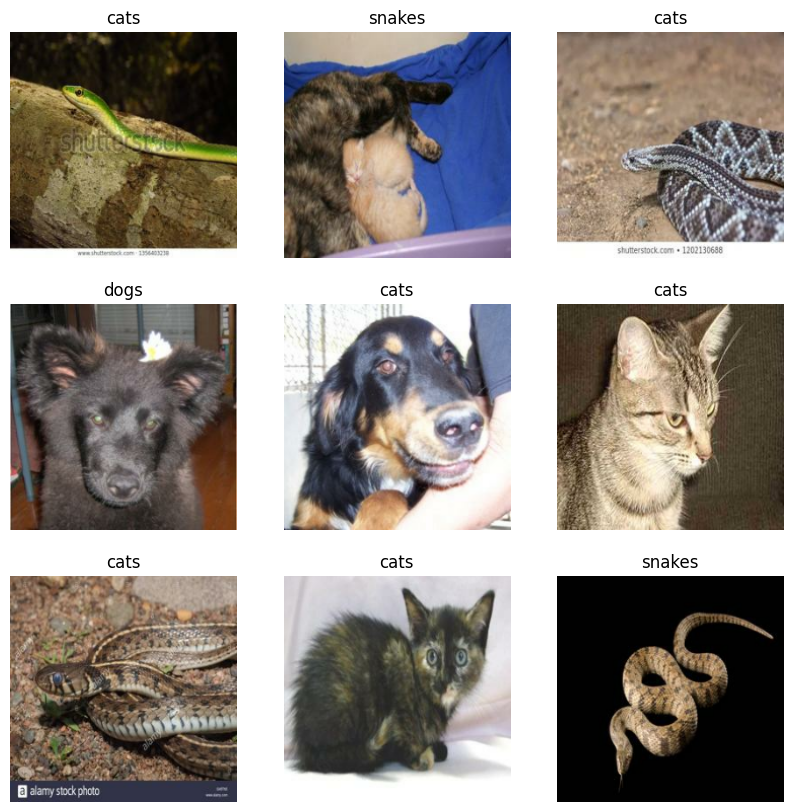

In [47]:
plt.figure(figsize=(10, 10))

df = test_ds.take(1)
pred = inc_model.predict(df)
for images, labels in df:
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[pred[i].argmax()])
    plt.axis("off")

In [48]:
print(classification_report(y_true, y_pred, target_names=list(class_names)))

              precision    recall  f1-score   support

        cats       0.60      0.76      0.67       107
        dogs       0.67      0.33      0.45        87
      snakes       0.72      0.82      0.77       106

   micro avg       0.66      0.66      0.66       300
   macro avg       0.66      0.64      0.63       300
weighted avg       0.66      0.66      0.64       300
 samples avg       0.66      0.66      0.66       300



Almacenamos el modelo para uso posterior.

In [49]:
inc_model.save('animal_inception.h5')

## 3.2. Entrenamiento con VGG16.

¿De dónde toma el nombre la red pre-entrenada?

> En este trabajo investigamos el efecto de la profundidad de la red convolucional en su precisión en el contexto del reconocimiento de imágenes a gran escala. Nuestra principal contribución es una evaluación exhaustiva de redes con una profundidad creciente utilizando una arquitectura con filtros de convolución muy pequeños (3x3), lo que demuestra que se puede lograr una mejora significativa respecto a las configuraciones previas al aumentar la profundidad a 16-19 capas.

Simonyan, Zisserman, "*Very Deep Convolutional Networks for Large-Scale Image Recognition*", 2014.



### 3.2.1. Arquitectura de la red.

![Arquitectura VGG16](https://github.com/fcastellanosp/MINE-4210_202420_ADL/blob/main/Laboratorios/Laboratorio%202/images/vgg16.jpg?raw=true)

VGG obedece a Visual Geometry Group, el cuál desarrolado en un laboratorio de investigación de la universidad de Oxford.

Es una arquitectura clásica que tiene 2 o 3 capas convolucionales y una capa Pooling, seguido de 16 capas convolucionales (en el caso de VGG19 el número obedece a las 19 capas convolucionales), termina con 2 capas ocultas y la capa de salida con sus respectivos filtros.

### 3.2.2. Implementación.

In [50]:
vgg_base_model_obj = VGG16(
    input_shape=(img_height, img_width, band_count),
    include_top=False,
    weights="imagenet",
)

vgg_base_model_obj.summary()

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

In [51]:
for layer in vgg_base_model_obj.layers:
  layer.trainable = False

In [52]:
x = vgg_base_model_obj.output

**Fully Connected**

In [53]:
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu', name='Capa_Densa_1')(x)
x = Dropout(0.2, name='Dropout')(x)
x = Dense(64, activation='relu', name='Capa_Densa_2')(x)

Capa de **Salida**

In [54]:
predictions = Dense(len(class_names), activation="softmax", name='Capa_Respuesta')(x)

Definimos el modelo:

In [55]:
vgg_model = Model(inputs=vgg_base_model_obj.input, outputs=predictions, name='RCN_Con_Conocimiento_2')

Compilamos el modelo

In [56]:
vgg_model.compile(optimizer='adam',
                  loss=tf.keras.losses.CategoricalCrossentropy(),
                  metrics=["accuracy"]
)

Definimos la carpeta del TensorBoard:

In [57]:
log_dir2 = osp.join("logs", "fit2", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard2_callback = TensorBoard(log_dir=log_dir2, histogram_freq=1)

In [58]:
my_callbacks2 = [
    tf.keras.callbacks.EarlyStopping(patience=5), tensorboard2_callback
]

Verificamos cómo quedó construido nuestro modelo:

In [59]:
vgg_model.summary()

Model: "RCN_Con_Conocimiento_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_1           │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ Capa_Densa_1 (Dense)                 │ (None, 128)                 │          65,6

 Total params: 14,788,803 (56.41 MB)

 Trainable params: 74,115 (289.51 KB)

 Non-trainable params: 14,714,688 (56.13 MB)

Usamos la misma función de parada Temprana.

In [60]:
with tf.device('/device:GPU:0'):
  history = vgg_model.fit(train_ds, validation_data=val_ds, epochs=50, callbacks=my_callbacks2)

Epoch 1/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 36s 277ms/step - accuracy: 0.7690 - loss: 1.1426 - val_accuracy: 0.9200 - val_loss: 0.1942
Epoch 2/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 181ms/step - accuracy: 0.9544 - loss: 0.1308 - val_accuracy: 0.9233 - val_loss: 0.1705
Epoch 3/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 14s 182ms/step - accuracy: 0.9664 - loss: 0.0852 - val_accuracy: 0.9400 - val_loss: 0.1426
Epoch 4/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 20s 178ms/step - accuracy: 0.9841 - loss: 0.0501 - val_accuracy: 0.9467 - val_loss: 0.1848
Epoch 5/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 14s 181ms/step - accuracy: 0.9847 - loss: 0.0419 - val_accuracy: 0.9500 - val_loss: 0.1605
Epoch 6/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 14s 180ms/step - accuracy: 0.9943 - loss: 0.0196 - val_accuracy: 0.9500 - val_loss: 0.1319
Epoch 7/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 14s 180ms/step - accuracy: 0.9919 - loss: 0.0244 - val_accuracy: 0.9533 - val_loss: 0.1637
Epoch 8/50
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 181ms/step - accuracy: 0.9963 - loss: 0.0139 - val_accu

Verificamos cómo entrenó:

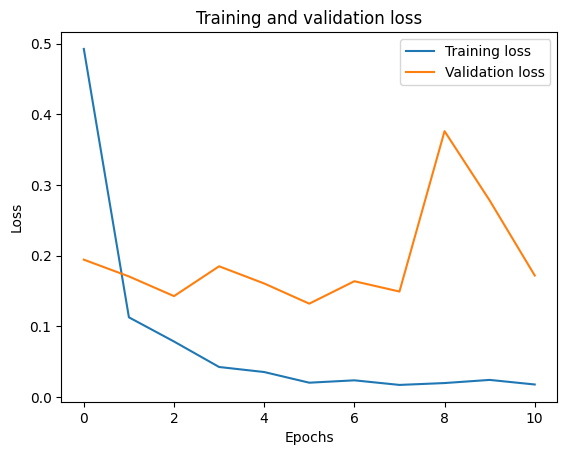

In [61]:
plt.plot(history.history['loss'], label='Training loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

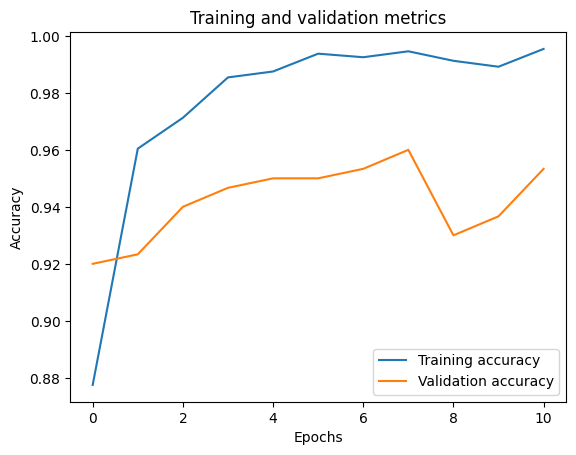

In [62]:
plt.plot(history.history['accuracy'], label='Training accuracy')
plt.plot(history.history['val_accuracy'], label='Validation accuracy')
plt.title('Training and validation metrics')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

Visualizamos de forma especializada con el TensorBoard:

In [63]:
%load_ext tensorboard
%tensorboard --logdir logs/fit2

Output hidden; open in https://colab.research.google.com to view.

### 3.2.3. Predicción.

Realizamos el mismo ajuste del modelo anterior:

In [64]:
y_true = list()
y_pred = list()

for images, labels in train_ds:
  pred = vgg_model.predict(images)
  for i in range(len(pred)):
    y_true.append(labels[i].numpy())
    y_pred.append((pred[i] == pred[i].max()).astype(int))

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_true, y_pred

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━

(array([[0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        ...,
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.]], dtype=float32),
 array([[0, 1, 0],
        [0, 1, 0],
        [0, 1, 0],
        ...,
        [1, 0, 0],
        [1, 0, 0],
        [1, 0, 0]]))

Vemos las métricas:

In [65]:
print(classification_report(y_true, y_pred, target_names=list(class_names)))

              precision    recall  f1-score   support

        cats       1.00      1.00      1.00       790
        dogs       1.00      1.00      1.00       809
      snakes       1.00      1.00      1.00       801

   micro avg       1.00      1.00      1.00      2400
   macro avg       1.00      1.00      1.00      2400
weighted avg       1.00      1.00      1.00      2400
 samples avg       1.00      1.00      1.00      2400



### 3.2.4. Validación.

Veamos la predicción aplicada en las imágenes:

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


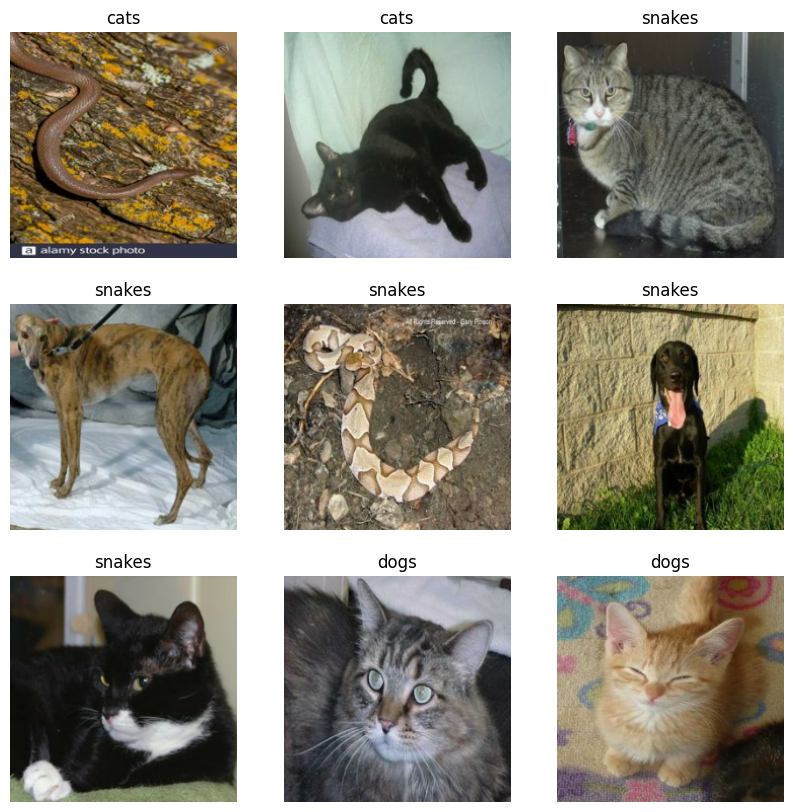

In [66]:
plt.figure(figsize=(10, 10))

df = train_ds.take(1)
pred = vgg_model.predict(df)
for images, labels in df:
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[pred[i].argmax()])
    plt.axis("off")

Las métricas obtenidas del proceso:

In [67]:
print(classification_report(y_true, y_pred, target_names=list(class_names)))

              precision    recall  f1-score   support

        cats       1.00      1.00      1.00       790
        dogs       1.00      1.00      1.00       809
      snakes       1.00      1.00      1.00       801

   micro avg       1.00      1.00      1.00      2400
   macro avg       1.00      1.00      1.00      2400
weighted avg       1.00      1.00      1.00      2400
 samples avg       1.00      1.00      1.00      2400



### 3.2.5. Prueba.

¿Y con imágenes que no conoce?

In [68]:
y_true = list()
y_pred = list()

for images, labels in test_ds:
  pred = vgg_model.predict(images)
  for i in range(len(pred)):
    y_true.append(labels[i].numpy())
    y_pred.append((pred[i] == pred[i].max()).astype(int))

y_true = np.array(y_true)
y_pred = np.array(y_pred)
y_true, y_pred

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step


(array([[0., 0., 1.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 0., 1.],
        [0., 1., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 0., 1.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 0., 1.],
        [1., 0., 0.],
        [0., 0., 1.],
        [0., 1., 0.],
        [1., 0., 0.],
        [0

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


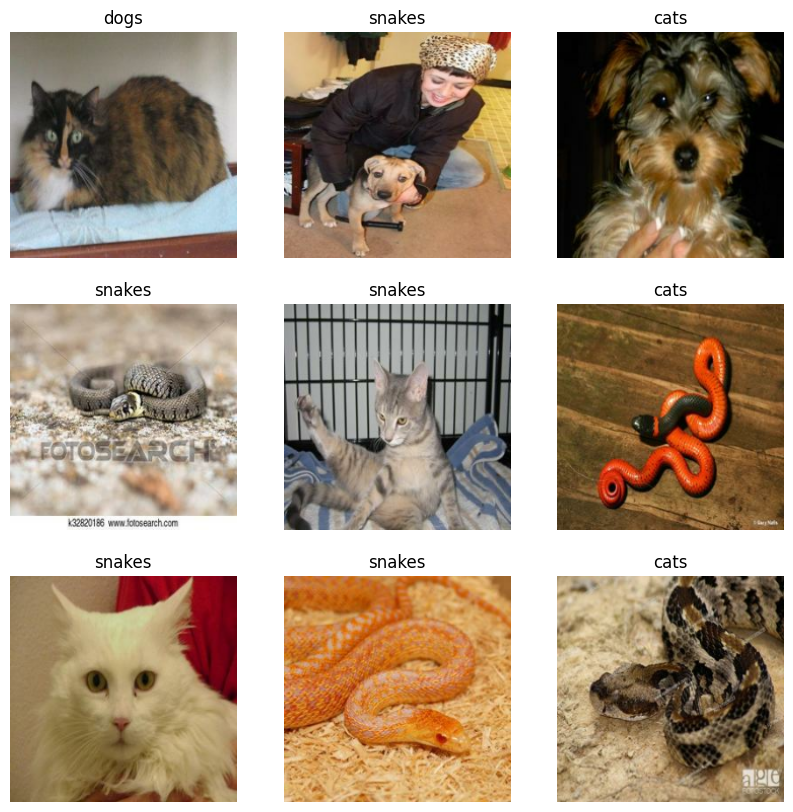

In [69]:
plt.figure(figsize=(10, 10))

df = test_ds.take(1)
pred = vgg_model.predict(df)
for images, labels in df:
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[pred[i].argmax()])
    plt.axis("off")

Las métricas del proceso:

In [70]:
print(classification_report(y_true, y_pred, target_names=list(class_names)))

              precision    recall  f1-score   support

        cats       0.96      0.92      0.94       107
        dogs       0.91      0.97      0.94        87
      snakes       0.98      0.98      0.98       106

   micro avg       0.95      0.95      0.95       300
   macro avg       0.95      0.95      0.95       300
weighted avg       0.95      0.95      0.95       300
 samples avg       0.95      0.95      0.95       300



Almacenamos el proceso para uso posterior:

In [71]:
vgg_model.save('animal_vgg.h5')

---
# 4. Preguntas.

*   ¿Qué hiperparámetros deberíamos buscar y ajustar?
*   ¿Qué otras Redes Pre-entrenadas podemos utilizar en nuestro modelo?
*   ¿Será conveniente realizar diferentes transferencias de conocimiento?
*   ¿El balance de clases podría incidir en los resultados obtenidos?
*   ¿Qué ocurriría si no congelamos el modelo base (Trainable=False)?
*   ¿Qué podría estar generando la diferencia entre los 2 modelos aplicados?.